# Sentiment analysis from movies reviews

Taken from https://hub.packtpub.com/how-to-perform-sentiment-analysis-using-python-tutorial/

### 1. First we import the necessary packages

We will use the NLTK NLP Python library, if the library is not installed, you'll have to install it using one of these commands:
* `pip install nltk`
* `conda install nltk`

In [1]:
import nltk.classify.util

from nltk.classify import NaiveBayesClassifier
from nltk.corpus import movie_reviews

### 2. Make sure that we have the movie_reviews dataset downloaded

This is a dataset that comes included in NLTK. Once the dataset has already been downloaded, you don't need to do it again.

In [2]:
try:
    movie_reviews.categories()
except:
    print('This appears to be your first time using the NLTK Movie Reviews corpus. We will first download the necessary corpus (this is a one-time download that might take a little while')
    nltk.download('movie_reviews')

### 3. Define a very simple function for extracting features

Here we will define features as the vocabulary in our corpus and we will create a dictionary to model a one-hot boolean encoding for each of the evaluated reviews.

In [3]:
def extract_features(word_list):
    return dict([(word, True) for word in word_list])

### 4. Separate positive reviews from negative reviews
The `movie_reviews` dataset contains a list of file names with each of the reviews stored in a TXT file. Let's separate the file names containing the positive reviews and the negative reviews.

In [4]:
# Load positive and negative reviews  
positive_fileids = movie_reviews.fileids('pos')
negative_fileids = movie_reviews.fileids('neg')

### 5. Extract the features from each of the positive reviews and negative reviews

As we mentioned earlier, our features in this context are simple words. By extracting the features we will construct a dictionary that tells us if a positive review contains a certain word or not.

In [5]:
features_positive = [(extract_features(movie_reviews.words(fileids=[f])), 
       'Positive') for f in positive_fileids]
features_negative = [(extract_features(movie_reviews.words(fileids=[f])), 
       'Negative') for f in negative_fileids]

print(f"Number of positive features: {len(features_positive)}")
print(f"Number of negative features: {len(features_negative)}")

Number of positive features: 1000
Number of negative features: 1000


In [6]:
features_positive

[({'films': True,
   'adapted': True,
   'from': True,
   'comic': True,
   'books': True,
   'have': True,
   'had': True,
   'plenty': True,
   'of': True,
   'success': True,
   ',': True,
   'whether': True,
   'they': True,
   "'": True,
   're': True,
   'about': True,
   'superheroes': True,
   '(': True,
   'batman': True,
   'superman': True,
   'spawn': True,
   ')': True,
   'or': True,
   'geared': True,
   'toward': True,
   'kids': True,
   'casper': True,
   'the': True,
   'arthouse': True,
   'crowd': True,
   'ghost': True,
   'world': True,
   'but': True,
   'there': True,
   's': True,
   'never': True,
   'really': True,
   'been': True,
   'a': True,
   'book': True,
   'like': True,
   'hell': True,
   'before': True,
   '.': True,
   'for': True,
   'starters': True,
   'it': True,
   'was': True,
   'created': True,
   'by': True,
   'alan': True,
   'moore': True,
   'and': True,
   'eddie': True,
   'campbell': True,
   'who': True,
   'brought': True,
   'm

In [7]:
features_negative

[({'plot': True,
   ':': True,
   'two': True,
   'teen': True,
   'couples': True,
   'go': True,
   'to': True,
   'a': True,
   'church': True,
   'party': True,
   ',': True,
   'drink': True,
   'and': True,
   'then': True,
   'drive': True,
   '.': True,
   'they': True,
   'get': True,
   'into': True,
   'an': True,
   'accident': True,
   'one': True,
   'of': True,
   'the': True,
   'guys': True,
   'dies': True,
   'but': True,
   'his': True,
   'girlfriend': True,
   'continues': True,
   'see': True,
   'him': True,
   'in': True,
   'her': True,
   'life': True,
   'has': True,
   'nightmares': True,
   'what': True,
   "'": True,
   's': True,
   'deal': True,
   '?': True,
   'watch': True,
   'movie': True,
   '"': True,
   'sorta': True,
   'find': True,
   'out': True,
   'critique': True,
   'mind': True,
   '-': True,
   'fuck': True,
   'for': True,
   'generation': True,
   'that': True,
   'touches': True,
   'on': True,
   'very': True,
   'cool': True,
   '

### 6. Split the data into train/test by calculating the index at which we have to cut off the list of features

In [8]:
# Split the data into train and test (80/20)
threshold_factor = 0.8
threshold_positive = int(threshold_factor * len(features_positive))
threshold_negative = int(threshold_factor * len(features_negative))

In [9]:
features_train = features_positive[:threshold_positive] + features_negative[:threshold_negative]
features_test = features_positive[threshold_positive:] + features_negative[threshold_negative:]  
print(f"Number of training datapoints: {len(features_train)}")
print(f"Number of test datapoints: {len(features_test)}")

Number of training datapoints: 1600
Number of test datapoints: 400


### 7. Using the training features, let's train a Naive Bayes Classifier

First, let's review a few concepts.

#### What is a classifier?
A classifier is a machine learning model that is used to discriminate different objects based on certain features.

#### Principle of Naive Bayes Classifier:
A Naive Bayes classifier is a probabilistic machine learning model that’s used for classification task. The crux of the classifier is based on the Bayes theorem.

#### Bayes Theorem:

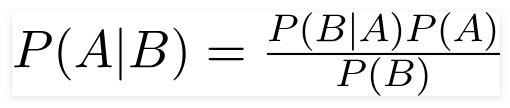

By using Bayes theorem, we can find the probability of A happening, given that B has occurred. Here, B is the evidence and A is the hypothesis. The assumption made here is that the predictors/features are independent. In other words, the presence of one particular feature does not affect the other, hence it is called naive.

In [10]:
# Train a Naive Bayes classifier
classifier = NaiveBayesClassifier.train(features_train)
print(f"Accuracy of the classifier: {nltk.classify.util.accuracy(classifier, features_test)}")

Accuracy of the classifier: 0.735


In [11]:
print("Top 10 most informative words:\n")
for item in classifier.most_informative_features()[:10]:
    print(item[0])

Top 10 most informative words:

outstanding
insulting
vulnerable
ludicrous
uninvolving
avoids
astounding
fascination
symbol
darker


### 8. Let's introduce new reviews and attempt to calculate the probability of the sentiment in it

In [12]:
# Sample input reviews
input_reviews = [
   "It is an amazing movie", 
   "This is a dull movie. I would never recommend it to anyone.",
   "The cinematography is pretty great in this movie", 
   "The direction was terrible and the story was all over the place"
]

In [13]:
print("Predictions:\n")

for review in input_reviews:
    print(f"Review: {review}")
    probdist = classifier.prob_classify(extract_features(review.split()))
    pred_sentiment = probdist.max()
    
    print(f"Predicted sentiment: {pred_sentiment}") 
    print(f"Probability: {round(probdist.prob(pred_sentiment), 2)}")
    print("***************\n")

Predictions:

Review: It is an amazing movie
Predicted sentiment: Positive
Probability: 0.61
***************

Review: This is a dull movie. I would never recommend it to anyone.
Predicted sentiment: Negative
Probability: 0.77
***************

Review: The cinematography is pretty great in this movie
Predicted sentiment: Positive
Probability: 0.67
***************

Review: The direction was terrible and the story was all over the place
Predicted sentiment: Negative
Probability: 0.63
***************

